In [1]:
import tensorflow as tf
from matplotlib import pyplot as plt
import numpy as np
import os

# Pre-process and load Dataset

In [8]:
PATH = './data/final_rd_data'

#load model
generator = tf.keras.models.load_model('./models/generatorv5_final_rd_3.h5')

SAMPLES_TO_SHOW = 100

output_folder = 'final_road_output_3'

In [9]:
# The facade training set consist of 400 images
BUFFER_SIZE = 400
# The batch size of 1 produced better results for the U-Net in the original pix2pix experiment
BATCH_SIZE = 1
# Each image is 512x512 in size
IMG_WIDTH = 512
IMG_HEIGHT = 512


def load(image_file):
  print('imagefile' + image_file)
  # Read and decode an image file to a uint8 tensor
  image = tf.io.read_file(image_file)
  image = tf.io.decode_jpeg(image)

  # Split each image tensor into two tensors:
  # - one with a real building facade image
  # - one with an architecture label image
  w = tf.shape(image)[1]
  w = w // 2
  input_image = image[:, w:, :]
  real_image = image[:, :w, :]

  # Convert both images to float32 tensors
  input_image = tf.cast(input_image, tf.float32)
  real_image = tf.cast(real_image, tf.float32)

  # Get image index from image name
  filename = tf.strings.split(image_file, sep='/')[-1]
  index = tf.strings.split(filename, sep='.')[0]
  print('index: ' + str(index))

  return input_image, real_image, index

def resize(input_image, real_image, height, width):
  input_image = tf.image.resize(input_image, [height, width], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  real_image = tf.image.resize(real_image, [height, width], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  return input_image, real_image

# Normalizing the images to [-1, 1]
def normalize(input_image, real_image):
  input_image = (input_image / 127.5) - 1
  real_image = (real_image / 127.5) - 1

  return input_image, real_image

def load_image_test(image_file):
  input_image, real_image, index = load(image_file)
  input_image, real_image = resize(input_image, real_image,
                                   IMG_HEIGHT, IMG_WIDTH)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image, index


# try:
test_dataset = tf.data.Dataset.list_files(str(PATH + '/test/*.png'))
# except tf.errors.InvalidArgumentError:
#   test_dataset = tf.data.Dataset.list_files(str(PATH + '/val/*.png'))
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(BATCH_SIZE)


Tensor("add:0", shape=(), dtype=string)
index: Tensor("strided_slice_4:0", shape=(), dtype=string)


# Generate single ouptputs

In [4]:
def generate_images(model, test_input, tar, index):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15, 15))
  print(index)

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # Getting the pixel values in the [0, 1] range to plot.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

tf.Tensor([b'1811_input_4'], shape=(1,), dtype=string)


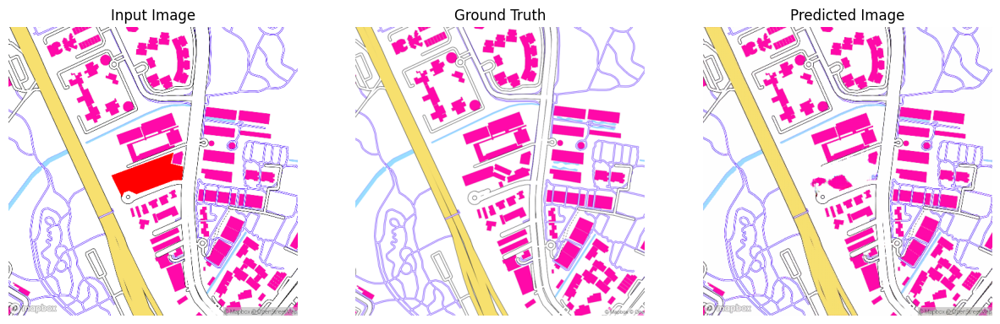

tf.Tensor([b'1811_input_5'], shape=(1,), dtype=string)


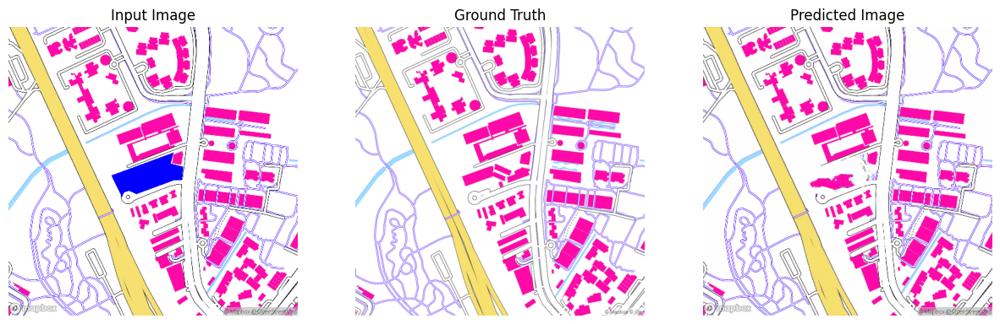

tf.Tensor([b'434_input_3'], shape=(1,), dtype=string)


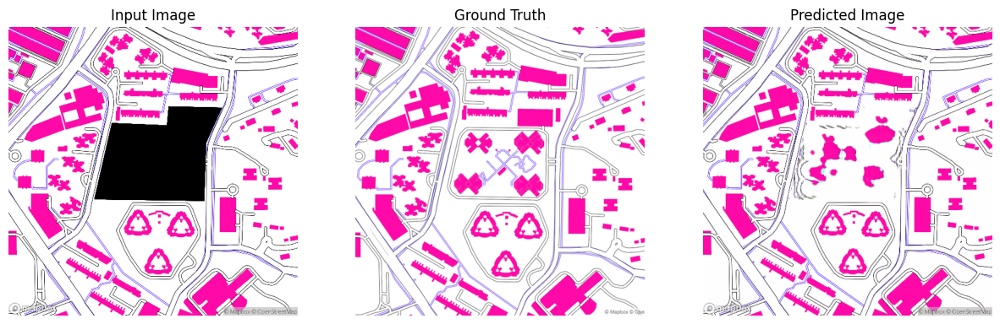

tf.Tensor([b'1811_input_3'], shape=(1,), dtype=string)


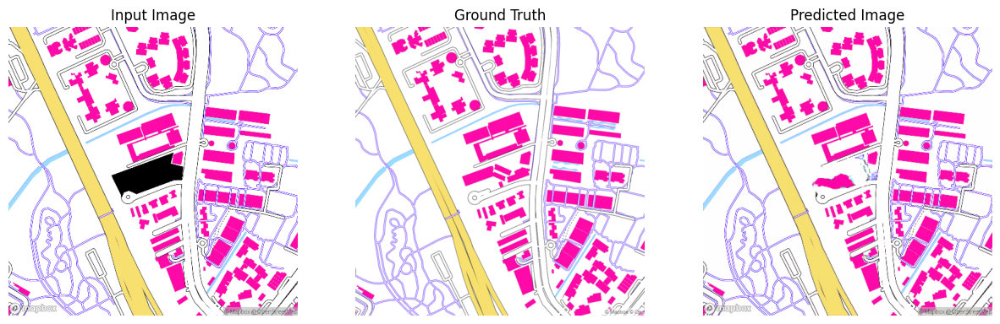

tf.Tensor([b'434_input_2'], shape=(1,), dtype=string)


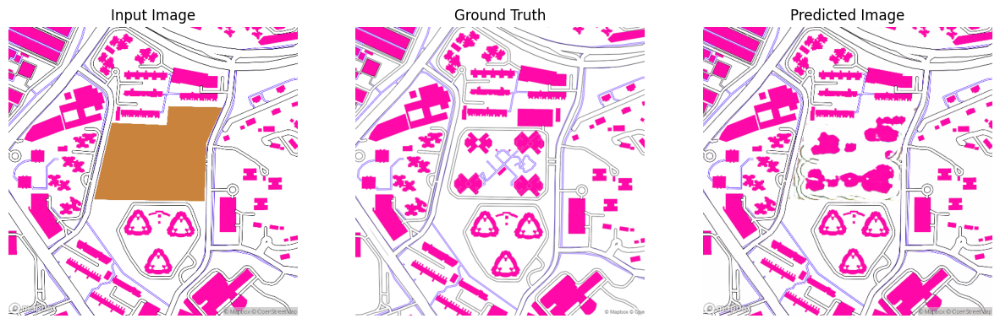

tf.Tensor([b'434_input_1'], shape=(1,), dtype=string)


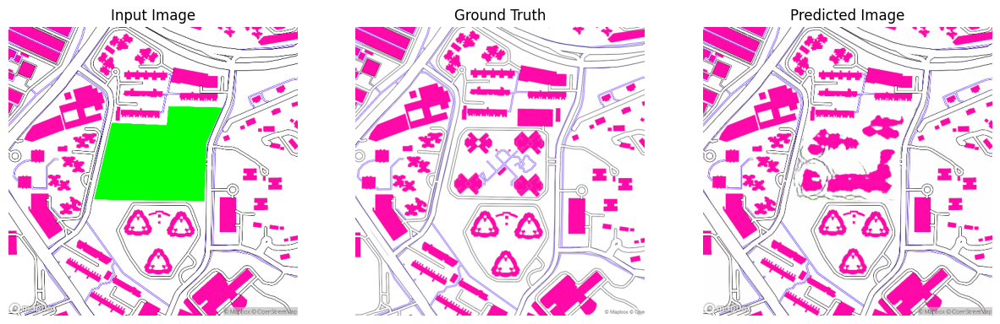

tf.Tensor([b'1811_input_1'], shape=(1,), dtype=string)


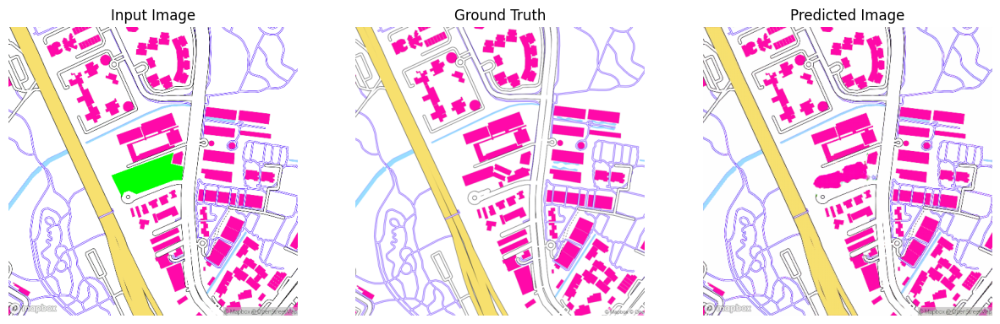

tf.Tensor([b'1811_input_2'], shape=(1,), dtype=string)


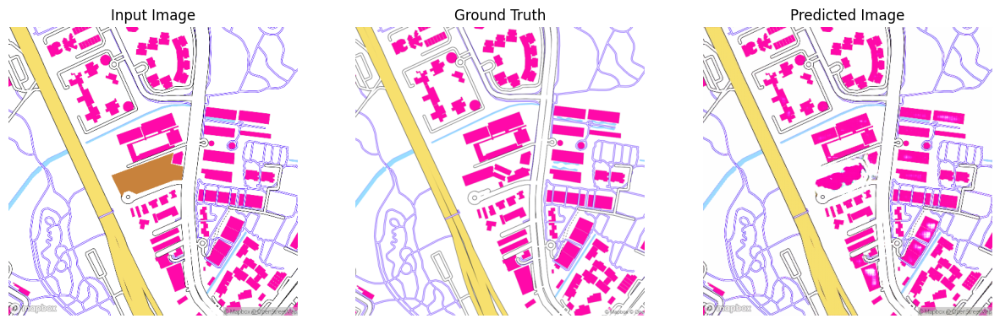

tf.Tensor([b'434_input_4'], shape=(1,), dtype=string)


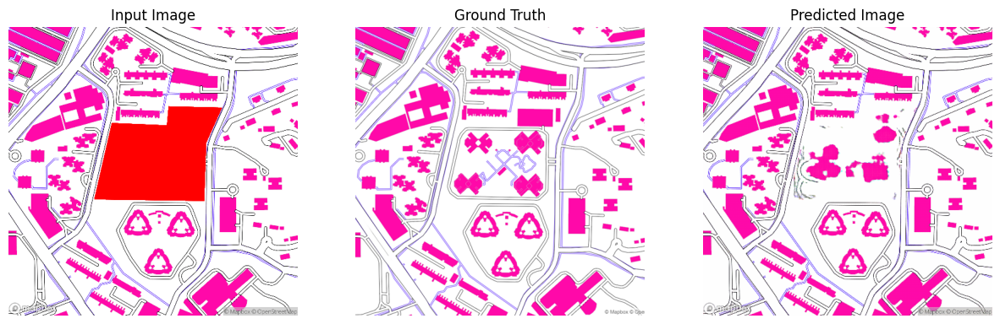

tf.Tensor([b'434_input_5'], shape=(1,), dtype=string)


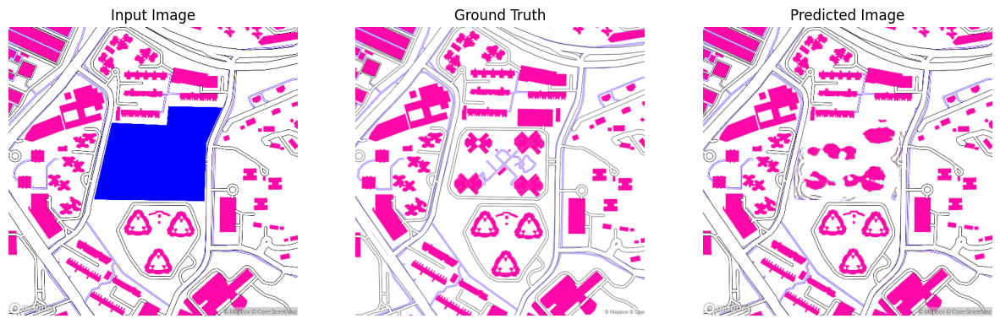

In [8]:
# run model on test data

for inp, tar, index in test_dataset.take(SAMPLES_TO_SHOW):
    generate_images(generator, inp, tar, index)

tf.Tensor([b'1811_input_4'], shape=(1,), dtype=string)


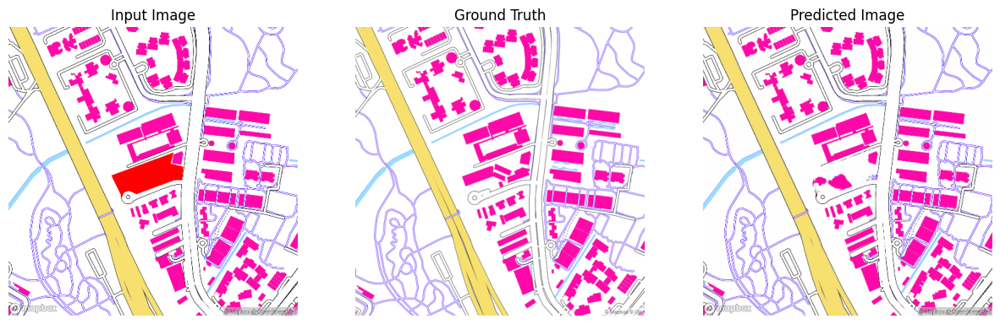

tf.Tensor([b'1811_input_1'], shape=(1,), dtype=string)


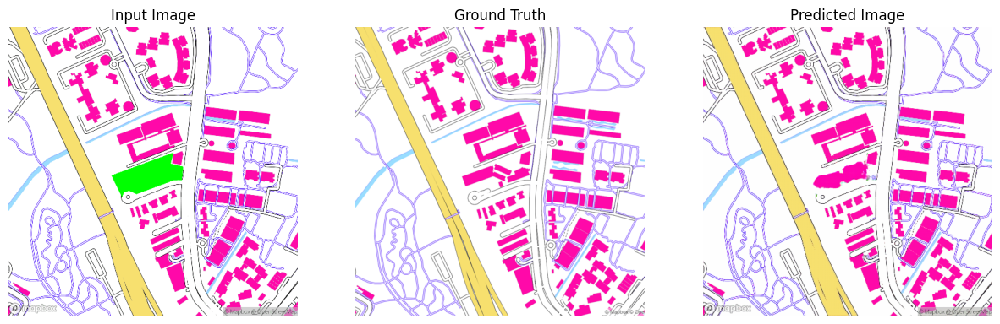

tf.Tensor([b'434_input_2'], shape=(1,), dtype=string)


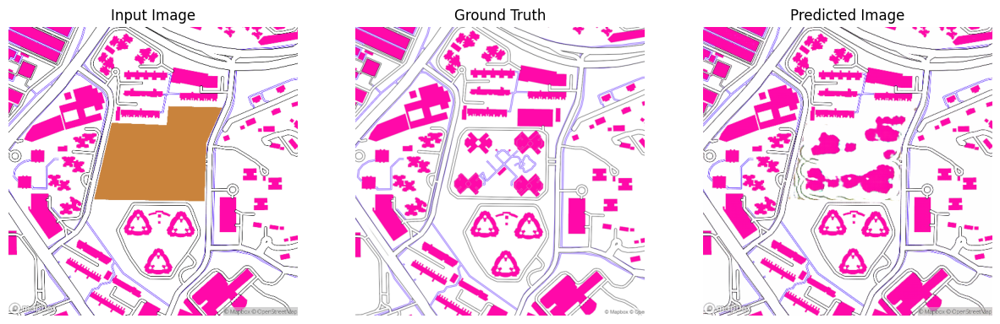

tf.Tensor([b'434_input_5'], shape=(1,), dtype=string)


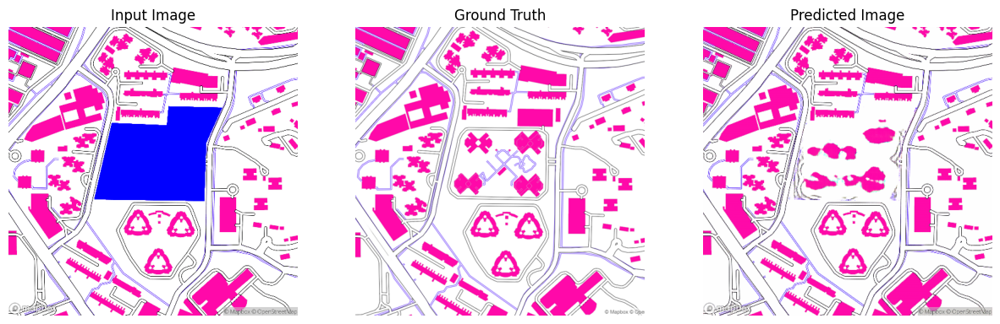

tf.Tensor([b'434_input_4'], shape=(1,), dtype=string)


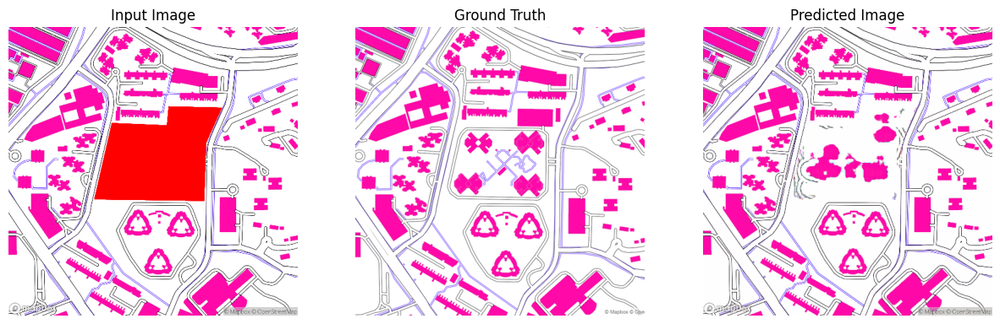

tf.Tensor([b'434_input_1'], shape=(1,), dtype=string)


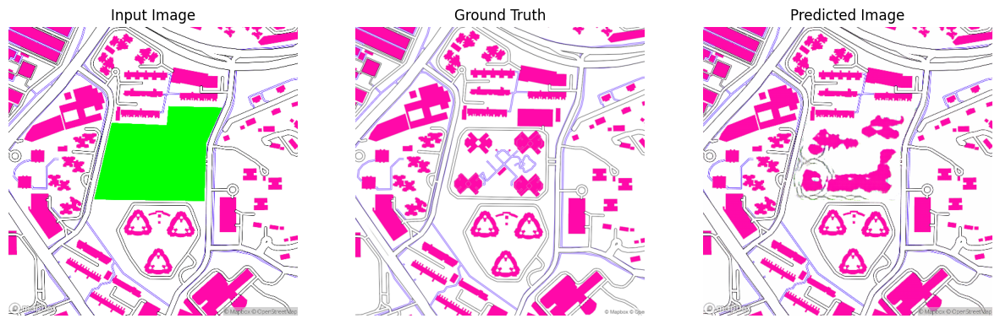

tf.Tensor([b'1811_input_5'], shape=(1,), dtype=string)


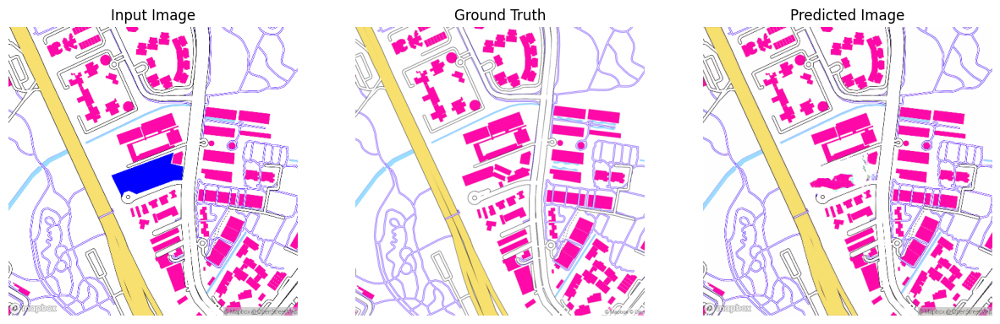

tf.Tensor([b'1811_input_3'], shape=(1,), dtype=string)


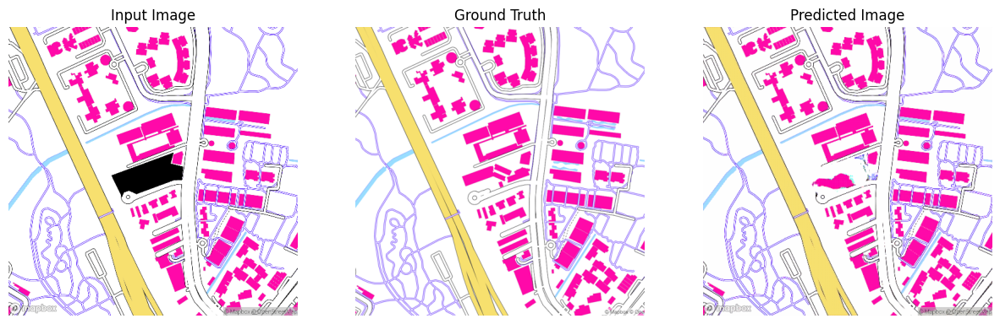

tf.Tensor([b'1811_input_2'], shape=(1,), dtype=string)


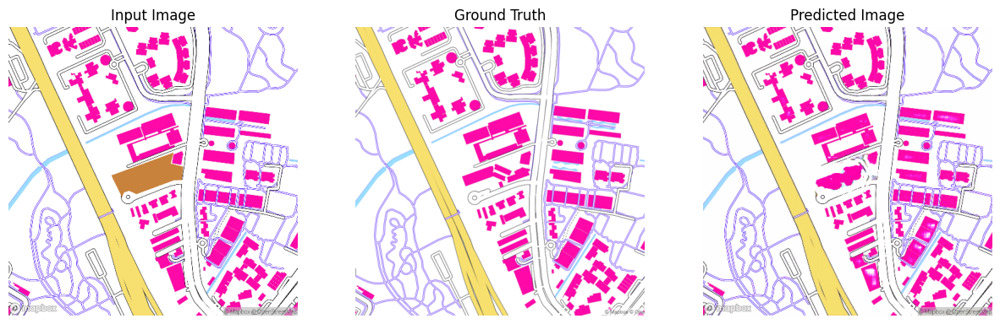

tf.Tensor([b'434_input_3'], shape=(1,), dtype=string)


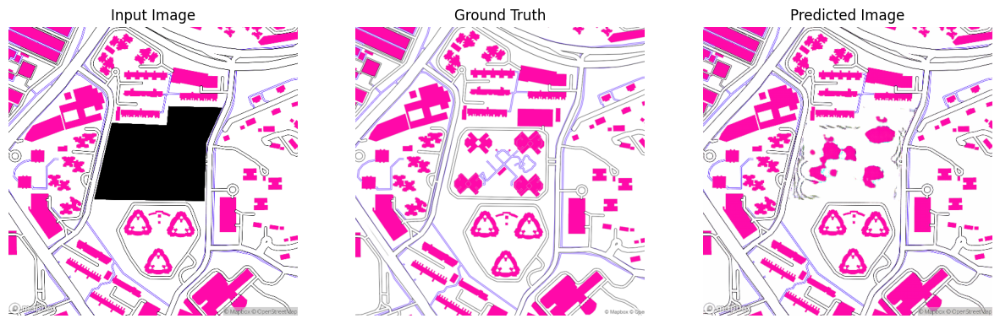

# Generate variations (noise) - outdated method

In [20]:
# Constants for image dimensions
IMG_WIDTH = 512
IMG_HEIGHT = 512

In [21]:
# Define separate functions for adding noise and adjusting contrast and brightness
def add_noise(image, noise_level=0.1):
    # Add Gaussian noise to the image
    noise = tf.random.normal(shape=tf.shape(image), mean=0.0, stddev=noise_level, dtype=tf.float32)
    noisy_image = image + noise
    noisy_image = tf.clip_by_value(noisy_image, clip_value_min=-1.0, clip_value_max=1.0)  # Keep image in the valid range
    return noisy_image

def adjust_contrast_and_brightness(image, contrast_factor=1.0, brightness_delta=0.0):
    # Adjust contrast and brightness of the image
    contrast_image = tf.image.adjust_contrast(image, contrast_factor)
    bright_image = tf.image.adjust_brightness(contrast_image, brightness_delta)
    bright_image = tf.clip_by_value(bright_image, clip_value_min=-1.0, clip_value_max=1.0)  # Keep image in the valid range
    return bright_image

In [22]:
# Define the function to generate variations and display them
def display_image_variations(model, input_image, real_image):
    # Create variations
    variation1 = add_noise(input_image, noise_level=0.3)
    variation2 = adjust_contrast_and_brightness(input_image, contrast_factor=1.2, brightness_delta=0.1)
    
    # Generate predictions for each variation
    prediction1 = model(input_image, training=True)
    prediction2 = model(variation1, training=True)
    prediction3 = model(variation2, training=True)
    
    
    # Display the images
    plt.figure(figsize=(20, 10))

    titles = ['Input Image', 'Ground Truth', 'Variation 1', 'Variation 2', 'Variation 3']
    images = [input_image[0], real_image[0], prediction1[0], prediction2[0], prediction3[0]]

    for i in range(5):
        plt.subplot(1, 5, i + 1)
        plt.imshow(images[i])
        plt.title(titles[i])
        plt.axis('off')

    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


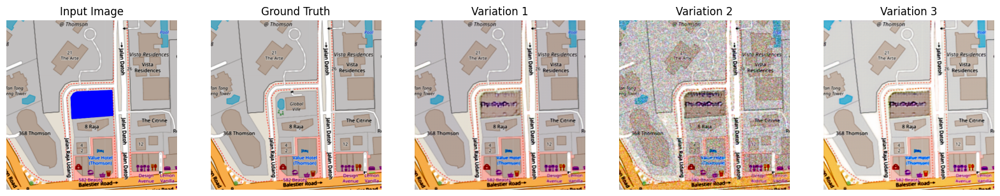

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


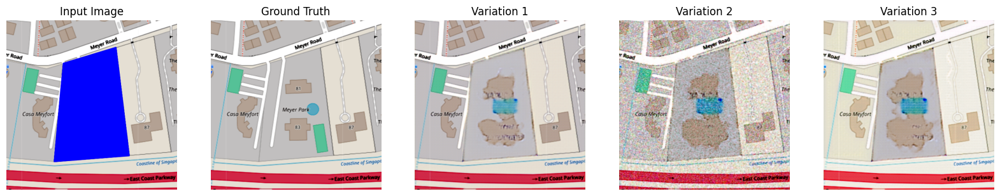

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


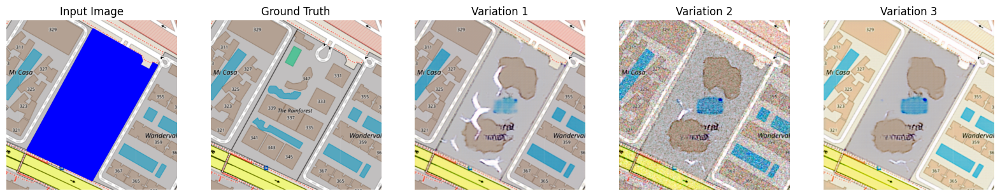

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


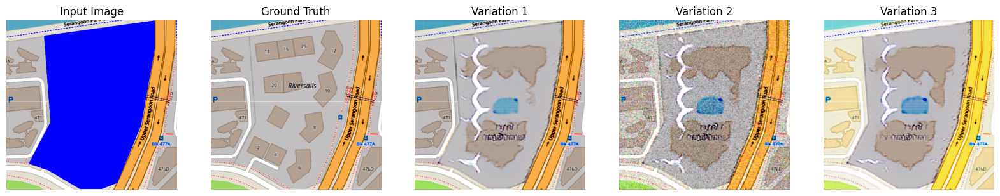

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


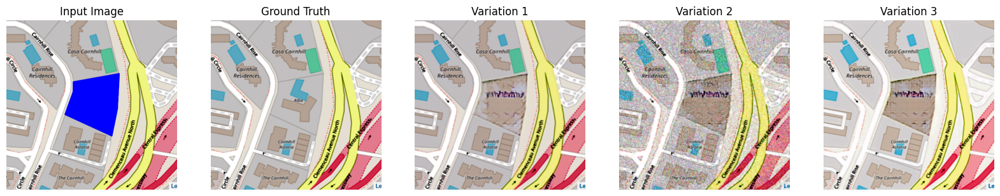

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


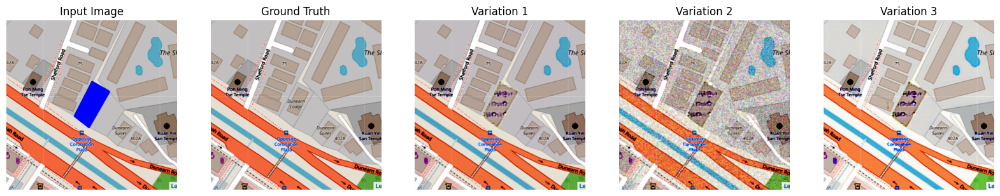

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


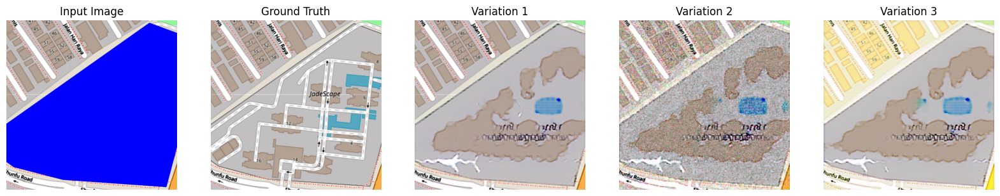

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


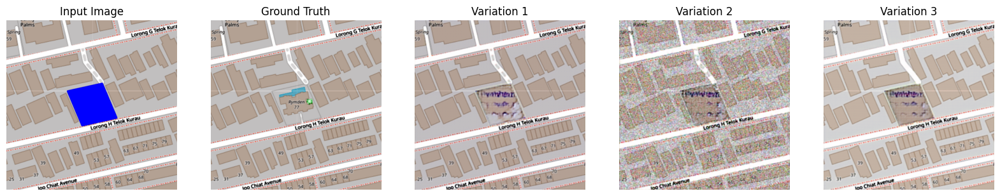

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


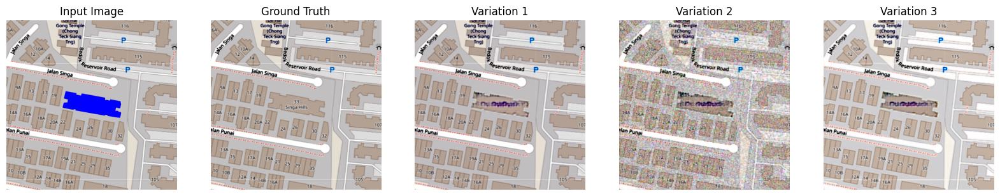

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


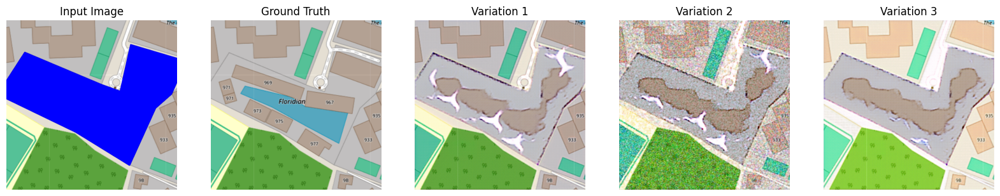

In [16]:
for inp, tar, index in test_dataset.take(10):
    display_image_variations(generator, inp, tar)

# Save all Test Outputs in as a folder

In [10]:
output_path = './outputs/' + output_folder

if not os.path.exists(output_path):
    os.makedirs(output_path)

number_of_images =int(test_dataset.__len__())
print(number_of_images)

100


In [11]:
def save_output(model, test_input, index, ouput_path):
    prediction = model(test_input, training=True)

    # Convert the prediction to a suitable format
    predicted_image = prediction[0]
    predicted_image = (predicted_image * 0.5 + 0.5)  # Rescale to [0, 1]
    # predicted_image = tf.clip_by_value(predicted_image, 0, 1)  # Ensure values are within [0, 1]
    # predicted_image = tf.image.resize(predicted_image, [512, 512])  # Resize to 512x512

    #extract string from tensor
    index = index[0].numpy().decode("utf-8")
    print(index)

    # Save the predicted image
    save_path = os.path.join(output_path, f'{index}.png')
    plt.imsave(save_path, predicted_image.numpy())
    print('saved image: ' + save_path)

In [12]:
done = 0
for inp, _, index in test_dataset.take(number_of_images):  
    save_output(generator, inp, index, output_path)
    done += 1
    print(done)

489
saved image: ./outputs/final_road_output_3/489.png
1
255
saved image: ./outputs/final_road_output_3/255.png
2
222
saved image: ./outputs/final_road_output_3/222.png
3
1277
saved image: ./outputs/final_road_output_3/1277.png
4
143
saved image: ./outputs/final_road_output_3/143.png
5
1180
saved image: ./outputs/final_road_output_3/1180.png
6
235
saved image: ./outputs/final_road_output_3/235.png
7
1839
saved image: ./outputs/final_road_output_3/1839.png
8
566
saved image: ./outputs/final_road_output_3/566.png
9
365
saved image: ./outputs/final_road_output_3/365.png
10
434
saved image: ./outputs/final_road_output_3/434.png
11
428
saved image: ./outputs/final_road_output_3/428.png
12
879
saved image: ./outputs/final_road_output_3/879.png
13
1866
saved image: ./outputs/final_road_output_3/1866.png
14
1484
saved image: ./outputs/final_road_output_3/1484.png
15
1173
saved image: ./outputs/final_road_output_3/1173.png
16
709
saved image: ./outputs/final_road_output_3/709.png
17
1714
saved 

# Generate variations (models) - latest method

tf.Tensor([b'1811_input_4'], shape=(1,), dtype=string)


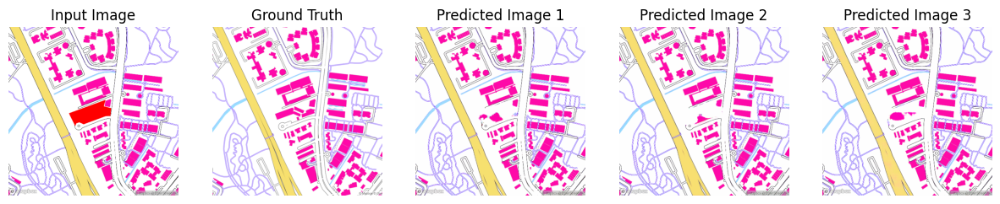

tf.Tensor([b'434_input_1'], shape=(1,), dtype=string)


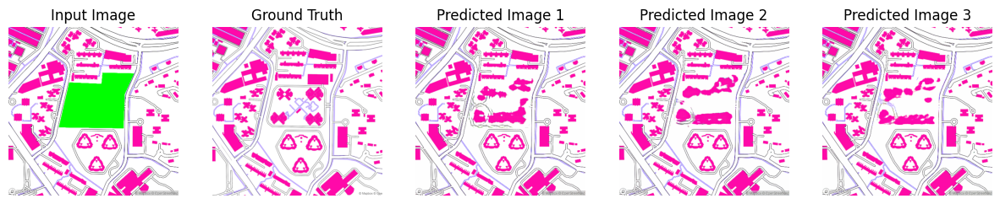

tf.Tensor([b'434_input_4'], shape=(1,), dtype=string)


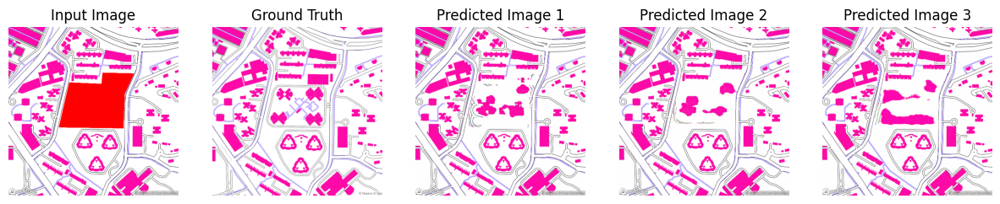

tf.Tensor([b'1811_input_2'], shape=(1,), dtype=string)


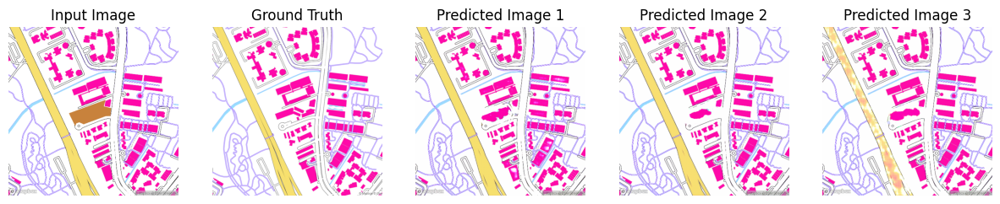

tf.Tensor([b'434_input_3'], shape=(1,), dtype=string)


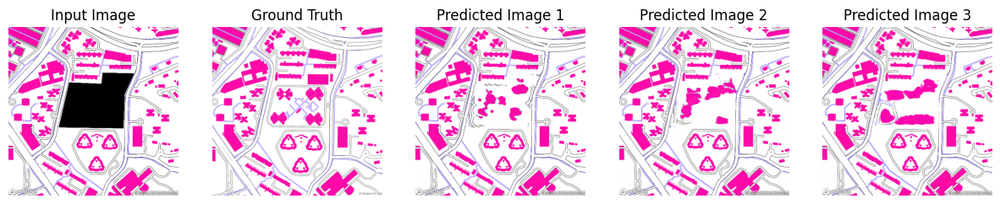

tf.Tensor([b'1811_input_1'], shape=(1,), dtype=string)


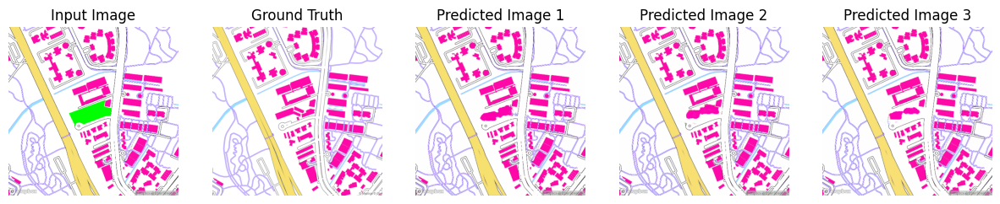

tf.Tensor([b'434_input_5'], shape=(1,), dtype=string)


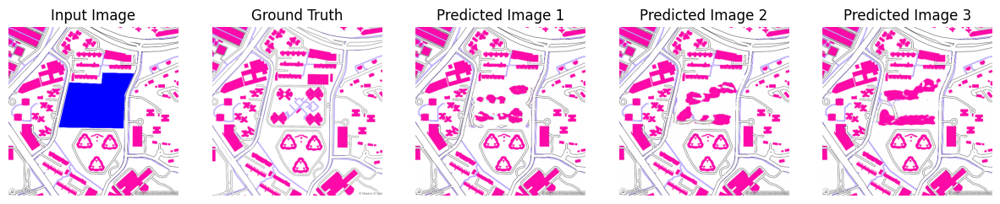

tf.Tensor([b'1811_input_5'], shape=(1,), dtype=string)


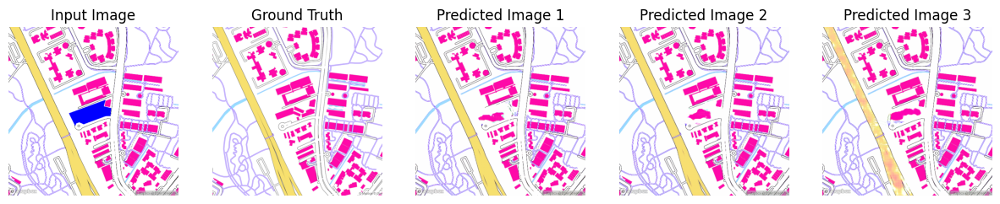

tf.Tensor([b'1811_input_3'], shape=(1,), dtype=string)


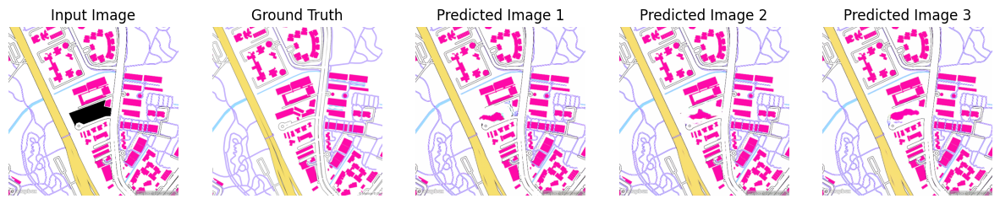

tf.Tensor([b'434_input_2'], shape=(1,), dtype=string)


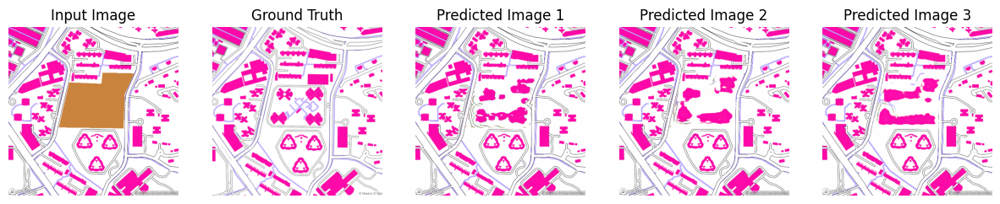

In [9]:
generator_name = 'generatorv5_final_rd'

generator1 = tf.keras.models.load_model('./models/' + generator_name + '_1.h5')
generator2 = tf.keras.models.load_model('./models/' + generator_name + '_2.h5')
generator3 = tf.keras.models.load_model('./models/' + generator_name + '_3.h5')

# show output of all three generators side by side
def generate_images_side_by_side(model1, model2, model3, test_input, tar, index):
  prediction1 = model1(test_input, training=True)
  prediction2 = model2(test_input, training=True)
  prediction3 = model3(test_input, training=True)
  plt.figure(figsize=(15, 15))
  print(index)

  display_list = [test_input[0], tar[0], prediction1[0], prediction2[0], prediction3[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image 1', 'Predicted Image 2', 'Predicted Image 3']

  for i in range(5):
    plt.subplot(1, 5, i+1)
    plt.title(title[i])
    # Getting the pixel values in the [0, 1] range to plot.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

# run model on test data

for inp, tar, index in test_dataset.take(100):
    generate_images_side_by_side(generator1, generator2, generator3, inp, tar, index)
    